<a href="https://colab.research.google.com/github/GerardoMunoz/ML_2025/blob/main/Regression_Kernels.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Regresión y Kernels**




## **I. Generación de Datos de Ejemplo**

To illustrate each technique, we generate a sample dataset:



In [1]:
import matplotlib.animation as animation
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def plot_model_3d(f, X, y, scaler=None, title="Model Surface Plot"):
    """
    Plots the given regression model as a 3D surface along with the training data.

    Parameters:
        model: Trained regression model (should have a `.predict()` method).
        X: Original feature matrix (before scaling).
        y: Target values.
        scaler: Scaler used to normalize the features (if any). Default is None.
        title: Title of the plot.
    """

    # Extract original features
    X1, X2 = X[:, 0], X[:, 1]

    # Create a grid over which to evaluate the model
    X1_grid, X2_grid = np.meshgrid(np.linspace(X1.min(), X1.max(), 20),
                                   np.linspace(X2.min(), X2.max(), 20))
    X_grid = np.column_stack((X1_grid.ravel(), X2_grid.ravel()))

    # Apply scaling if a scaler is provided
    if scaler:
        X_grid_scaled = scaler.transform(X_grid)
    else:
        X_grid_scaled = X_grid

    # Predict on the grid
    y_grid_pred = f(X_grid_scaled).reshape(X1_grid.shape)

    # Create figure and 3D axis
    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection='3d')

    # Plot the surface
    surf=ax.plot_surface(X1_grid, X2_grid, y_grid_pred, cmap="viridis", alpha=0.7)

    # Scatter plot of training data
    #ax.scatter(X1, X2, y, color="r", label="Training Data", alpha=0.7)

    # Create figure and 3D axis
    #fig = plt.figure(figsize=(8, 6))

    #ax = fig.add_subplot(111, projection='3d')

    # Scatter plot
    ax.scatter(X1, X2, y, label="Training Data", color="b")
    #ax.scatter(X1, X2, y_pred_linear, label="Linear Regression", color="r", alpha=0.6)

    # Labels and title
    ax.set_xlabel("X1")
    ax.set_ylabel("X2")
    ax.set_zlabel("y")
    ax.set_title(title)
    plt.legend()

    # Function to update the view angle
    def rotate(angle):
        ax.view_init(elev=20, azim=angle)
        return ax,

    # Create animation rotating from the initial position to +90° azimuth
    ani = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 91, 9), interval=200, blit=False)

    # Display the animation
    from IPython.display import HTML
    return HTML(ani.to_jshtml())

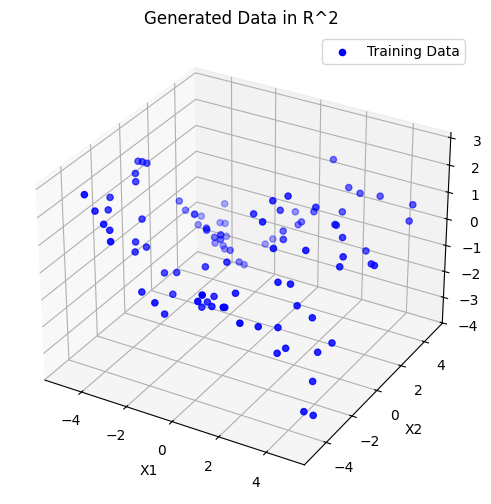

In [2]:
# Re-run the setup since execution state was reset
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression, Ridge, Lasso, LogisticRegression
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.kernel_ridge import KernelRidge
from sklearn.metrics.pairwise import rbf_kernel

# Step 1: Generate synthetic dataset in R^2
np.random.seed(42)
n_samples = 100

X1 = np.random.uniform(-5, 5, n_samples)
X2 = np.random.uniform(-5, 5, n_samples)
X = np.column_stack((X1, X2))

# Define a nonlinear function for y
def nonlinear_function(X1, X2):
    return np.sin(X1) + np.cos(X2) + 0.1 * X1 * X2 #+ np.random.normal(0, 0.2, len(X1))

def nonlinear_function_1(X):
    return nonlinear_function(X[:, 0], X[:, 1])


y= nonlinear_function(X1, X2)
#y = np.sin(X1) + np.cos(X2) + 0.1 * X1 * X2 + np.random.normal(0, 0.2, n_samples)

# Normalize features for better kernel performance
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Visualizing the dataset
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X1, X2, y, label="Training Data", color="b")

ax.set_xlabel("X1")
ax.set_ylabel("X2")
ax.set_zlabel("y")
ax.set_title("Generated Data in R^2")
plt.legend()
plt.show()

# Storing dataset for further regressions
dataset = {"X": X_scaled, "y": y}


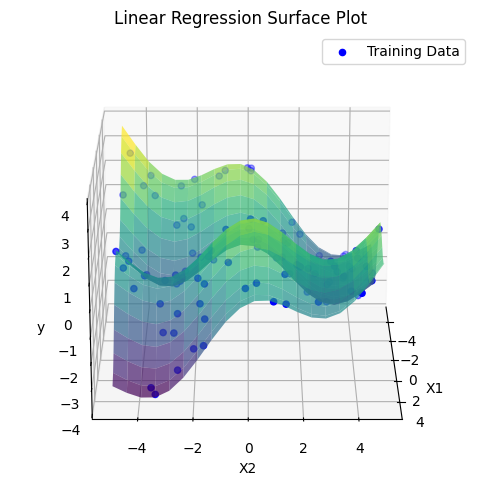

In [3]:
plot_model_3d(nonlinear_function_1, X, y, scaler=None, title="Linear Regression Surface Plot")

## **II. Multilineal Regression**



$y = \beta_0 + \beta_1 x_1 + \beta_2 x_2 + ... + \beta_n x_n + \varepsilon$

# **Solving Linear Regression: Different Methods**

Linear regression aims to model the relationship between input $ X $ and output $ y $ by estimating the best-fitting coefficients $ \beta $ in:

$$
y = X \beta + \varepsilon
$$

Several methods can be used to find $ \beta $, depending on data size, computational constraints, and regularization needs.

---

## **1. Pseudoinverse Solution (Closed-Form)**
- Uses the **Moore-Penrose inverse** to find an exact solution in **one step**.
- Formula:

  $$
  \beta = (X^T X)^{-1} X^T y
  $$

- **Use Case:** Small datasets where **matrix inversion is feasible**.
- **Advantage:** Fast and provides an **exact solution**.
- **Limitation:** Not practical for **high-dimensional or ill-conditioned** matrices.

---

## **2. Gradient Descent (Iterative Solution)**
- Optimizes $ \beta $ by minimizing the loss function:

  $$
  L(\beta) = \sum (y_i - X_i \beta)^2
  $$

- Update rule (for learning rate $ \eta $):

  $$
  \beta^{(t+1)} = \beta^{(t)} - \eta \nabla L(\beta)
  $$

- **Use Case:** Large datasets where matrix inversion is computationally expensive.
- **Advantage:** Works for **high-dimensional and streaming data**.
- **Limitation:** Requires tuning of **learning rate** and multiple iterations.

---

## **3. Ridge Regression (L2 Regularization)**
- Adds a **penalty on large coefficients** to reduce overfitting:

  $$
  L(\beta) = \sum (y_i - X_i \beta)^2 + \lambda \sum \beta_j^2
  $$

- Solution:

  $$
  \beta = (X^T X + \lambda I)^{-1} X^T y
  $$

- **Use Case:** When data is **collinear or noisy**.
- **Advantage:** Prevents **overfitting** and improves generalization.
- **Limitation:** Does not perform **feature selection**.

---

## **4. Lasso Regression (L1 Regularization)**
- Uses an **L1 penalty** to force some coefficients to be exactly **zero**:

  $$
  L(\beta) = \sum (y_i - X_i \beta)^2 + \lambda \sum |\beta_j|
  $$

- **Use Case:** When **feature selection** is needed.
- **Advantage:** Creates **sparse models**, selecting only the most important features.
- **Limitation:** Can be unstable when features are **highly correlated**.

---

## **5. Comparison of Methods**
| Method           | Computational Cost | Handles Large Datasets? | Regularization? | Feature Selection? |
|-----------------|-------------------|------------------------|----------------|------------------|
| **Pseudoinverse** | High (Matrix Inversion) | ❌ No  | ❌ No  | ❌ No  |
| **Gradient Descent** | Medium (Iterative) | ✅ Yes | ❌ No | ❌ No |
| **Ridge Regression** | Medium | ✅ Yes | ✅ L2 | ❌ No |
| **Lasso Regression** | Medium | ✅ Yes | ✅ L1 | ✅ Yes |



---


#

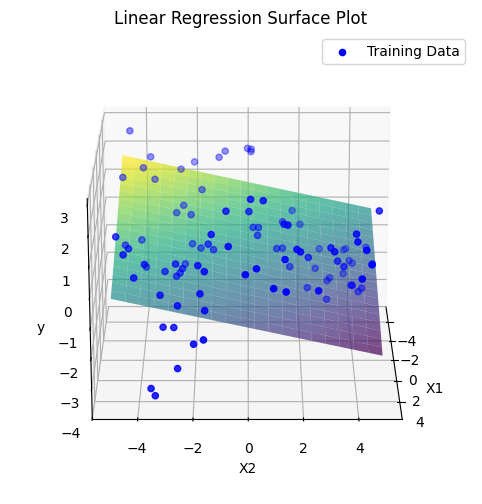

In [4]:
from sklearn.linear_model import LinearRegression
# Step 2: Apply Linear Regression
linear_model = LinearRegression()
linear_model.fit(dataset["X"], dataset["y"])
#y_pred_linear = linear_model.predict(dataset["X"])

plot_model_3d(linear_model.predict, X, y, scaler=None, title="Linear Regression Surface Plot")

## **III Basis Functions in Regression**

#### **1. Polynomial Basis (Polynomial Regression)**
- Uses powers of the input variable.
- Example:

  $$
  Y = \beta_0 + \beta_1X + \beta_2X^2 + \beta_3X^3 + \dots + \beta_nX^n + \epsilon
  $$

- **Use case**: Capturing non-linearity in data.

#### **2. Trigonometric Basis (Fourier Features)**
- Uses sine and cosine functions to capture periodic patterns.
- Example:

  $$
  Y = \beta_0 + \beta_1 \sin(X) + \beta_2 \cos(X) + \beta_3 \sin(2X) + \beta_4 \cos(2X) + \dots
  $$

- **Use case**: Time-series analysis, seasonal trends.

#### **3. Exponential & Logarithmic Basis**
- Used when data grows or decays exponentially.
- Example:

  $$
  Y = \beta_0 + \beta_1 e^X + \beta_2 \ln(X) + \epsilon
  $$

- **Use case**: Population growth, radioactive decay.

#### **4. Gaussian Basis (Radial Basis Functions - RBF)**
- Uses Gaussian functions centered at different points.
- Example:

  $$
  \phi_i(X) = e^{-\frac{(X - \mu_i)^2}{2\sigma^2}}
  $$

- **Use case**: Kernel methods in machine learning, function approximation.

#### **5. Sigmoidal Basis**
- Uses sigmoid functions, similar to neural networks.
- Example:

  $$
  \phi_i(X) = \frac{1}{1 + e^{-(X - \mu_i)}}
  $$

- **Use case**: Classification, smooth transitions between values.

#### **6. Wavelet Basis**
- Uses wavelets for localized signal processing.
- Example: Haar wavelet, Daubechies wavelets.
- **Use case**: Signal compression, denoising.

#### **7. Piecewise (Splines) Basis**
- Uses piecewise polynomials for better local fitting.
- Example:

  $$
  Y = \beta_0 + \beta_1X + \beta_2 (X - k)^+ + \epsilon
  $$

- **Use case**: Smooth curve fitting without overfitting.




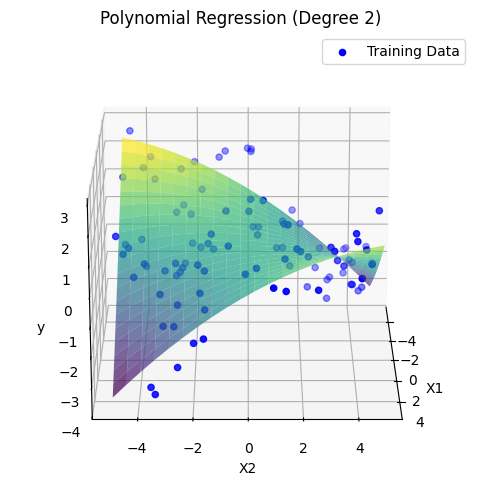

In [5]:
from sklearn.pipeline import make_pipeline

# Step 1: Create a Polynomial Regression Model (Degree 3)
poly_degree = 2  # Adjust for higher/lower complexity
poly_model = make_pipeline(PolynomialFeatures(degree=poly_degree), LinearRegression())

# Step 2: Train the Model
poly_model.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Polynomial Regression Model
plot_model_3d(poly_model.predict, X, y, scaler=scaler, title=f"Polynomial Regression (Degree {poly_degree})")


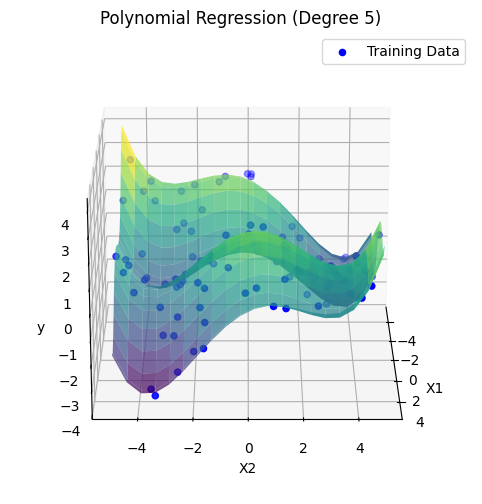

In [6]:
from sklearn.pipeline import make_pipeline

# Step 1: Create a Polynomial Regression Model (Degree 5)
poly_degree = 5  # Adjust for higher/lower complexity
poly_model = make_pipeline(PolynomialFeatures(degree=poly_degree), LinearRegression())

# Step 2: Train the Model
poly_model.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Polynomial Regression Model
plot_model_3d(poly_model.predict, X, y, scaler=scaler, title=f"Polynomial Regression (Degree {poly_degree})")


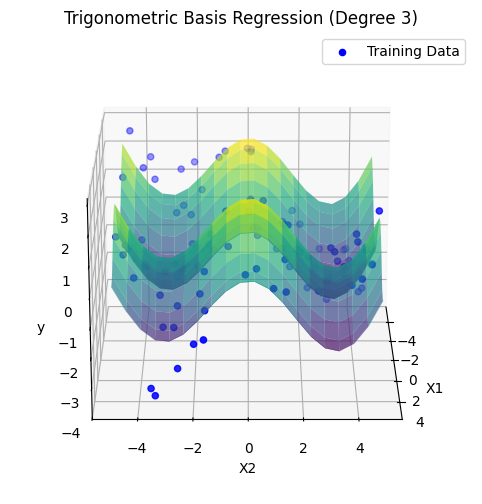

In [7]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression

# Step 1: Create a Custom Transformer for Trigonometric Basis
class TrigonometricFeatures(BaseEstimator, TransformerMixin):
    def __init__(self, degree=3):
        self.degree = degree

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X1, X2 = X[:, 0], X[:, 1]
        features = [np.ones(len(X))]  # Include bias term (constant 1)

        # Generate sine and cosine features up to the given degree
        for d in range(1, self.degree + 1):
            features.append(np.sin(d * X1))
            features.append(np.cos(d * X1))
            features.append(np.sin(d * X2))
            features.append(np.cos(d * X2))

        return np.column_stack(features)

# Step 2: Define the Model with Trigonometric Basis
trig_degree = 3  # Adjust for complexity
trig_model = make_pipeline(TrigonometricFeatures(degree=trig_degree), LinearRegression())

# Step 3: Train the Model
trig_model.fit(dataset["X"], dataset["y"])

# Step 4: Visualize the Model
plot_model_3d(trig_model.predict, X, y, scaler=scaler, title=f"Trigonometric Basis Regression (Degree {trig_degree})")


In [8]:
# from sklearn.preprocessing import PolynomialFeatures
# # Step 3: Apply Polynomial Regression (degree 3)
# poly = PolynomialFeatures(degree=6)
# X_poly = poly.fit_transform(dataset["X"])

# poly_model = LinearRegression()
# poly_model.fit(X_poly, dataset["y"])
# #y_pred_poly = poly_model.predict(X_poly)

# plot_model_3d(poly_model.predict, X, y, scaler=None, title="Degree 3 Polynomial Regression Surface Plot")

# **IV Activation Function**

## **1. Sigmoid Function (Logistic Regression)**
- **Formula:**
  
  $$
  \sigma(Z) = \frac{1}{1 + e^{-Z}}
  $$

- **Use Case:** **Binary classification** (e.g., spam vs. not spam).
- **Output Range:** (0,1) → Interpreted as probability.
- **Limitation:** Can be sensitive to extreme values.

---

## **2. Softmax Function (Multinomial Logistic Regression)**
- **Formula:**
  
  $$
  P(Y_i) = \frac{e^{Z_i}}{\sum_{j=1}^{k} e^{Z_j}}
  $$

- **Use Case:** **Multi-class classification** (e.g., classifying images into multiple categories).
- **Output Range:** (0,1), and all outputs sum to 1.
- **Advantage:** Converts raw scores into a **probability distribution** over multiple classes.

---

## **3. Hyperbolic Tangent (Tanh)**
- **Formula:**
  
  $$
  \tanh(Z) = \frac{e^Z - e^{-Z}}{e^Z + e^{-Z}}
  $$

- **Use Case:** Neural networks (activation function).
- **Output Range:** (-1,1), which helps with **zero-centered data**.
- **Advantage:** Unlike sigmoid, it outputs both positive and negative values.

---

## **4. Rectified Linear Unit (ReLU)**
- **Formula:**
  
  $$
  f(Z) = \max(0, Z)
  $$

- **Use Case:** **Deep learning models** (e.g., image recognition).
- **Output Range:** (0, ∞).
- **Advantage:** Helps avoid vanishing gradient problems.
- **Limitation:** Can suffer from **dying neurons** (where some neurons always output 0).

---

## **5. Exponential Function (Poisson Regression)**
- **Formula:**
  
  $$
  \lambda = e^Z
  $$

- **Use Case:** **Poisson regression** (predicting count data, e.g., number of website visits).
- **Output Range:** (0, ∞).
- **Advantage:** Ensures output is always positive (useful for modeling **counts**).

---

## **6. Log Transformation (Log-Linear Regression)**
- **Formula:**
  
  $$
  Y = \log(Z)
  $$

- **Use Case:** **Time series forecasting**, financial modeling.
- **Advantage:** Helps linearize exponential relationships and stabilize variance.

---

## **7. Probit Function (Probit Regression)**
- **Formula:**
  
  $$
  P(Y=1|X) = \Phi(Z)
  $$

  where $ \Phi(Z) $ is the **cumulative distribution function (CDF) of the normal distribution**.

- **Use Case:** **Binary classification** (like logistic regression).
- **Advantage:** The **Probit model** assumes a normal distribution of errors, making it useful in some economic models.

<!---

### **Comparison Table of Output Transformations**

| **Function** | **Equation** | **Range** | **Used In** |
|-------------|-------------|-----------|-------------|
| **Sigmoid** | $ \frac{1}{1+e^{-Z}} $ | (0,1) | Binary classification |
| **Softmax** | $ \frac{e^{Z_i}}{\sum e^{Z_j}} $ | (0,1), sums to 1 | Multi-class classification |
| **Tanh** | $ \frac{e^Z - e^{-Z}}{e^Z + e^{-Z}} $ | (-1,1) | Neural networks |
| **ReLU** | $ \max(0, Z) $ | (0,∞) | Deep learning |
| **Exponential** | $ e^Z $ | (0,∞) | Poisson regression (counts) |
| **Log Transform** | $ \log(Z) $ | (-∞,∞) | Time series, finance |
| **Probit** | $ \Phi(Z) $ | (0,1) | Probit regression |
--->

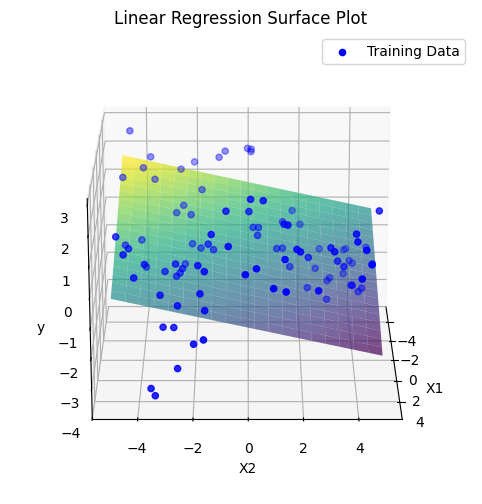

In [9]:
from sklearn.linear_model import LinearRegression
# Step 2: Apply Linear Regression
linear_model = LinearRegression()
linear_model.fit(dataset["X"], dataset["y"])
#y_pred_linear = linear_model.predict(dataset["X"])

plot_model_3d(linear_model.predict, X, y, scaler=None, title="Linear Regression Surface Plot")

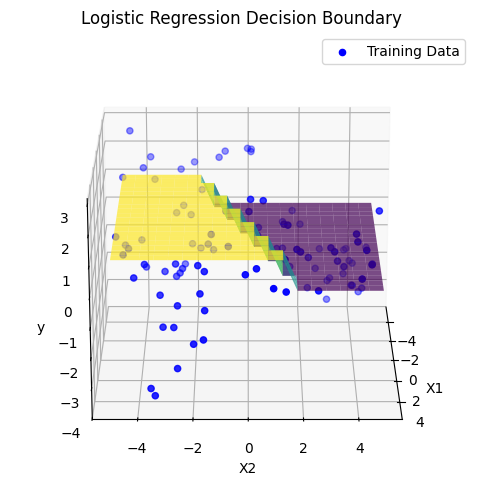

In [10]:
from sklearn.linear_model import LogisticRegression

# Step 1: Convert Regression Target to Binary Labels
y_class = (dataset["y"] > np.median(dataset["y"])).astype(int)  # 1 if above median, else 0

# Step 2: Train Logistic Regression Model
logistic_model = LogisticRegression()
logistic_model.fit(dataset["X"], y_class)

# Step 3: Visualize the Classification Decision Boundary
plot_model_3d(logistic_model.predict, X, y, scaler=scaler, title="Logistic Regression Decision Boundary")


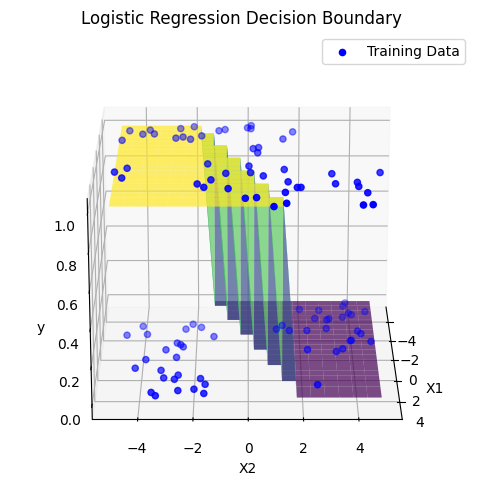

In [11]:
plot_model_3d(logistic_model.predict, X, y_class, scaler=scaler, title="Logistic Regression Decision Boundary")


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


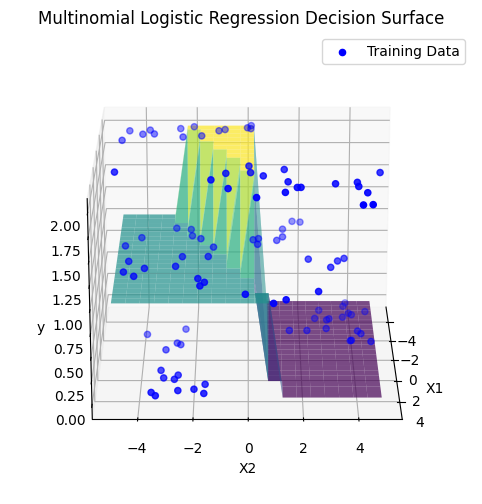

In [12]:
from sklearn.linear_model import LogisticRegression

# Step 1: Convert Regression Target to Three Categories
y_multiclass = np.digitize(dataset["y"], bins=np.percentile(dataset["y"], [33, 66]))

# Step 2: Train Multinomial Logistic Regression
multi_logistic_model = LogisticRegression(multi_class="multinomial", solver="lbfgs")
multi_logistic_model.fit(dataset["X"], y_multiclass)

# Step 3: Visualize the Multinomial Classification Decision Boundaries
plot_model_3d(multi_logistic_model.predict, X, y_multiclass, scaler=scaler, title="Multinomial Logistic Regression Decision Surface")


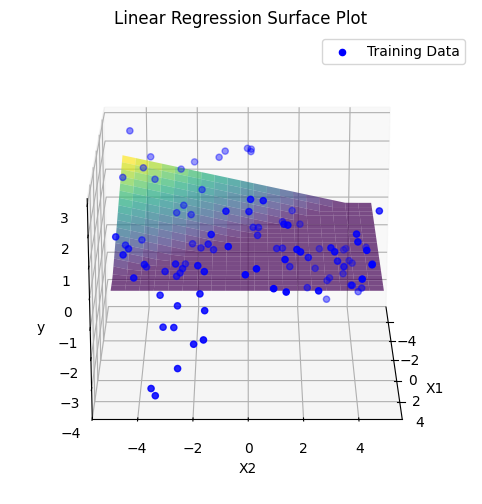

In [13]:
from sklearn.linear_model import LinearRegression

linear_model = LinearRegression()
linear_model.fit(dataset["X"], dataset["y"])

def relu(x):
    x1=linear_model.predict(x)
    return np.maximum(0, x1)

plot_model_3d(relu, X, y, scaler=None, title="Linear Regression Surface Plot")

# **V Principal Kernel Functions**

---

## **1. Linear Kernel**  
- **Formula:**  

  $$
  K(x, x') = x^T x'
  $$  

- **Use Case:** When the data is already **linearly separable**. Equivalent to standard **linear regression** or **linear SVM**.  
- **Computational Efficiency:** Fastest kernel, since it does not transform the input space.  
- **Limitation:** Cannot model **nonlinear** relationships.  

---

## **2. Polynomial Kernel**  
- **Formula:**  

  $$
  K(x, x') = (x^T x' + c)^d
  $$  

- **Use Case:** Useful when relationships between features follow a polynomial pattern.  
- **Hyperparameters:**  
  - $ d $ = degree of the polynomial (higher values allow more flexibility but risk overfitting).  
  - $ c $ = trade-off parameter (controls the influence of lower-degree terms).  
- **Advantage:** Captures curved decision boundaries.  
- **Limitation:** Computationally expensive for **high-degree** polynomials.  

---

## **3. Radial Basis Function (RBF) Kernel**  
- **Formula:**  

  $$
  K(x, x') = \exp \left( -\frac{\|x - x'\|^2}{2\sigma^2} \right)
  $$  

- **Use Case:** Most commonly used kernel; ideal when the decision boundary is highly **nonlinear**.  
- **Hyperparameters:**  
  - $ \sigma $ (or $ \gamma $) = controls how far two points must be to still influence each other.  
- **Advantage:** Very flexible, works well for most problems.  
- **Limitation:** Requires careful tuning of $ \sigma $ to avoid underfitting or overfitting.  

---

## **4. Sigmoid Kernel**  
- **Formula:**  

  $$
  K(x, x') = \tanh(\alpha x^T x' + c)
  $$  

- **Use Case:** Inspired by neural networks; behaves similarly to the **activation function** in a perceptron.  
- **Hyperparameters:**  
  - $ \alpha $ (scaling factor).  
  - $ c $ (offset parameter).  
- **Advantage:** Models relationships that resemble neural network behavior.  
- **Limitation:** Can suffer from convergence issues and is not as widely used as RBF.  

---


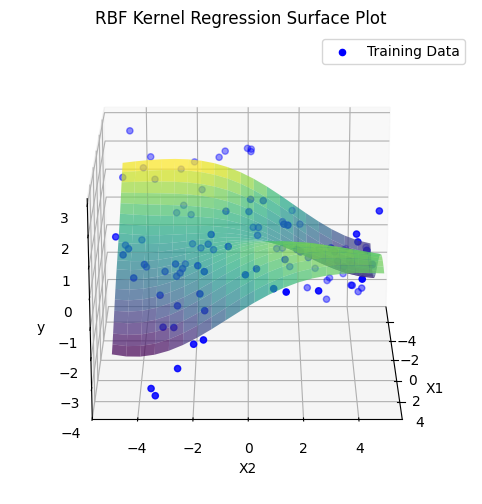

In [14]:
from sklearn.kernel_ridge import KernelRidge

# Step 1: Define the RBF Kernel Ridge Regression Model
rbf_regressor = KernelRidge(kernel="rbf", gamma=0.3)  # gamma controls the spread of the RBF kernel

# Step 2: Train the Model
rbf_regressor.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Kernel Regression Surface
plot_model_3d(rbf_regressor.predict, X, y, scaler=scaler, title="RBF Kernel Regression Surface Plot")


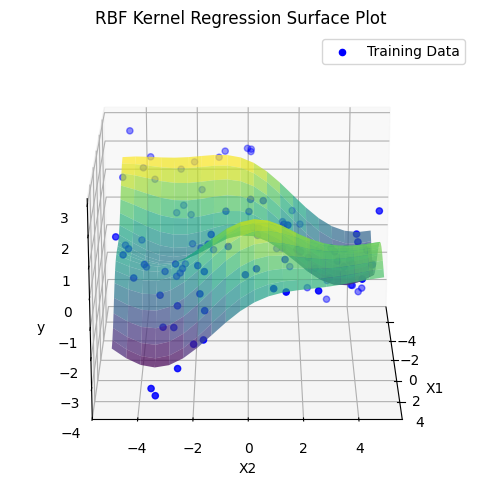

In [15]:
from sklearn.kernel_ridge import KernelRidge

# Step 1: Define the RBF Kernel Ridge Regression Model
rbf_regressor = KernelRidge(kernel="rbf", gamma=0.8)  # gamma controls the spread of the RBF kernel

# Step 2: Train the Model
rbf_regressor.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Kernel Regression Surface
plot_model_3d(rbf_regressor.predict, X, y, scaler=scaler, title="RBF Kernel Regression Surface Plot")


# **VI Lasso and Ridge Regression in Kernel Methods**

---

## **1. Ridge Regression (L2 Regularization)**  
- **Formula:**  

  $$
  \min_{\beta} \sum_{i=1}^{n} (y_i - X_i \beta)^2 + \lambda \sum_{j=1}^{p} \beta_j^2
  $$  

- **Use Case:** Prevents **overfitting** by penalizing large coefficients.  
- **Regularization Effect:** Shrinks coefficients **toward zero** but does not make them exactly zero.  
- **Hyperparameter:**  
  - $ \lambda $ controls the trade-off between **fit** and **regularization**.  
- **Advantage:** Works well when all features contribute **equally** to the prediction.  
- **Limitation:** Cannot perform **feature selection** (since coefficients never become exactly zero).  

---

## **2. Lasso Regression (L1 Regularization)**  
- **Formula:**  

  $$
  \min_{\beta} \sum_{i=1}^{n} (y_i - X_i \beta)^2 + \lambda \sum_{j=1}^{p} |\beta_j|
  $$  

- **Use Case:** Useful when some features are irrelevant (performs **automatic feature selection**).  
- **Regularization Effect:** Shrinks some coefficients **to exactly zero**, removing irrelevant features.  
- **Hyperparameter:**  
  - $ \lambda $ controls the strength of the regularization.  
- **Advantage:** Helps with **sparse models** (useful for high-dimensional data).  
- **Limitation:** Can be unstable when features are **highly correlated**.  

---

## **3. Ridge Regression with Kernels (Kernel Ridge Regression)**  
- **Formula:**  

  $$
  \hat{y} = K (K + \lambda I)^{-1} y
  $$  

- **Use Case:** Extends Ridge Regression to **nonlinear** problems using **kernels**.  
- **Key Idea:** Instead of learning weights in the original space, it learns weights in the **feature space** defined by a kernel.  
- **Advantage:** Works well with **high-dimensional and nonlinear** data.  
- **Limitation:** Computationally expensive when **many data points** are present.  

---

## **4. Lasso Regression with Kernels (Kernel Lasso)**  
- **Formula:**  

  $$
  \min_{\alpha} ||K \alpha - y||^2 + \lambda ||\alpha||_1
  $$  

- **Use Case:** Similar to Kernel Ridge, but with an **L1 penalty** to encourage sparsity in **feature space**.  
- **Advantage:** Performs **nonlinear feature selection** while keeping model complexity low.  
- **Limitation:** Solving L1 regularization in **kernel space** is computationally challenging.  

---



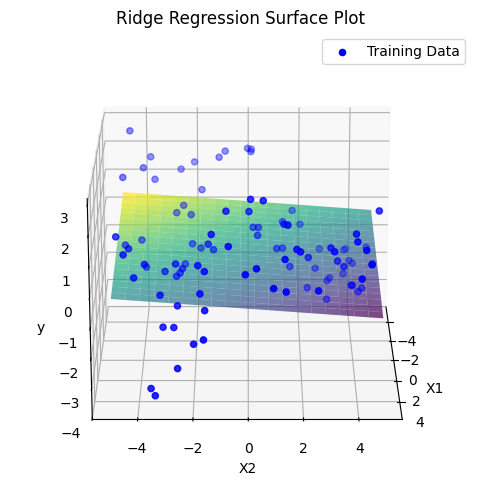

In [16]:
from sklearn.linear_model import Ridge

# Step 1: Define the Ridge Regression Model (without a kernel)
ridge_regressor = Ridge(alpha=1.0)  # alpha controls the L2 penalty (higher = more regularization)

# Step 2: Train the Model
ridge_regressor.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Ridge Regression Surface
plot_model_3d(ridge_regressor.predict, X, y, scaler=scaler, title="Ridge Regression Surface Plot")


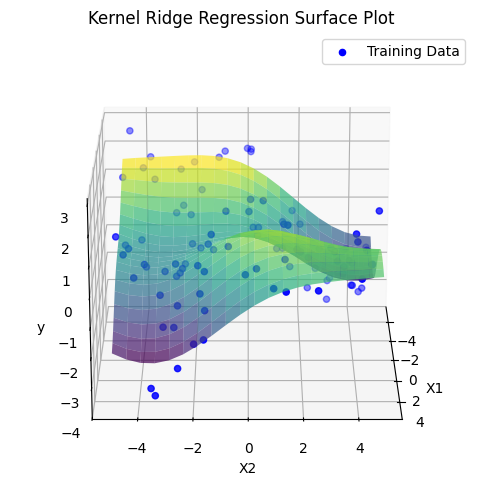

In [17]:
from sklearn.kernel_ridge import KernelRidge

# Step 1: Define the Kernel Ridge Regression Model
krr_regressor = KernelRidge(kernel="rbf", alpha=1.0, gamma=0.5)
# - kernel="rbf" → Uses Radial Basis Function (Gaussian) kernel.
# - alpha=1.0 → Controls L2 regularization (like Ridge).
# - gamma=0.5 → Determines the spread of the RBF kernel.

# Step 2: Train the Model
krr_regressor.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Kernel Ridge Regression Surface
plot_model_3d(krr_regressor.predict, X, y, scaler=scaler, title="Kernel Ridge Regression Surface Plot")


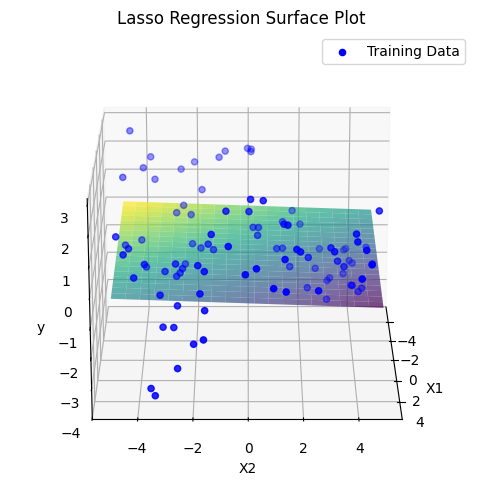

In [18]:
from sklearn.linear_model import Lasso

# Step 1: Define the Lasso Regression Model (without a kernel)
lasso_regressor = Lasso(alpha=0.1)  # alpha controls the L1 penalty (higher = more regularization)

# Step 2: Train the Model
lasso_regressor.fit(dataset["X"], dataset["y"])

# Step 3: Visualize the Lasso Regression Surface
plot_model_3d(lasso_regressor.predict, X, y, scaler=scaler, title="Lasso Regression Surface Plot")


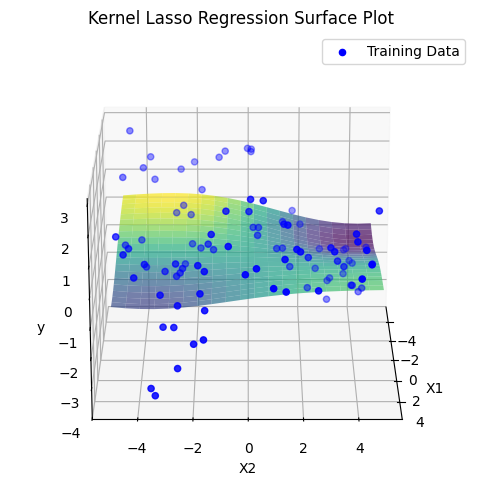

In [19]:
from sklearn.linear_model import Lasso
from sklearn.metrics.pairwise import rbf_kernel

# Step 1: Apply RBF Kernel Transformation
gamma = 0.5  # Defines how far the influence of a single training example reaches
X_kernelized = rbf_kernel(dataset["X"], dataset["X"], gamma=gamma)

# Step 2: Define the Lasso Regression Model
lasso_kernel_regressor = Lasso(alpha=0.1)  # L1 penalty to encourage sparsity

# Step 3: Train the Model
lasso_kernel_regressor.fit(X_kernelized, dataset["y"])

# Step 4: Visualize the Kernel Lasso Regression Surface
plot_model_3d(lambda X_new: lasso_kernel_regressor.predict(rbf_kernel(X_new, dataset["X"], gamma=gamma)),
              X, y, scaler=scaler, title="Kernel Lasso Regression Surface Plot")


# **VII Multilayer Regression and Its Applications in Artificial Neural Networks (ANNs)**

---

## **1. What is Multilayer Regression?**
Multilayer regression is an **extension of linear regression** where multiple transformations are applied to the input data before making predictions. This concept is fundamental in **Artificial Neural Networks (ANNs)**, where multiple layers of neurons process information sequentially.

- **Key Idea:** Instead of learning a single linear function, the model learns **multiple layers of functions** to capture **complex relationships**.
- **Difference from Linear Regression:**  
  - Linear regression finds a single mapping $ y = X \beta $.  
  - Multilayer regression applies **nonlinear transformations** through **hidden layers**.  

---

## **2. Multilayer Regression**
A neural network with one hidden layer applies the following transformations:

### **Step 1: Compute Hidden Layer Activations**
Given input $ X $ and weights $ W $, the hidden layer activations are:

  $$
  Z = f(XW + b)
  $$  

Where:
- $ W $ = weight matrix for the hidden layer.
- $ b $ = bias term.
- $ f(\cdot) $ = **activation function** (e.g., ReLU, Sigmoid, Tanh).

### **Step 2: Compute Output Layer**
After transformation, the output is:

  $$
  \hat{y} = g(ZV + c)
  $$  

Where:
- $ V $ = weight matrix for the output layer.
- $ c $ = output bias.
- $ g(\cdot) $ = activation function (e.g., Identity for regression, Softmax for classification).



/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


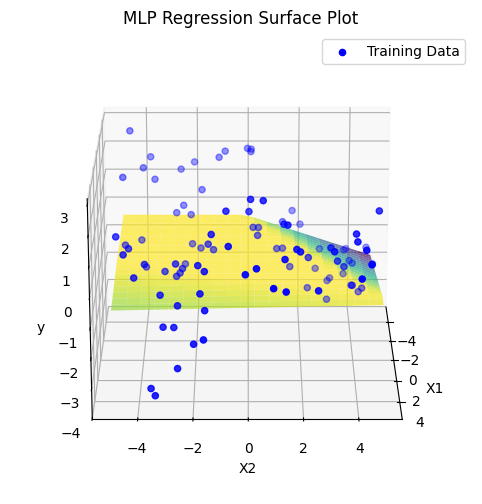

In [20]:
from sklearn.neural_network import MLPRegressor

# Step 1: Define and Train the Model
mlp_regressor = MLPRegressor(hidden_layer_sizes=(2, 2), activation='relu', solver='adam',
                             max_iter=1000, random_state=42)

mlp_regressor.fit(dataset["X"], dataset["y"])

# Step 2: Visualize the Model's Predictions
plot_model_3d(mlp_regressor.predict, X, y, scaler=scaler, title="MLP Regression Surface Plot")

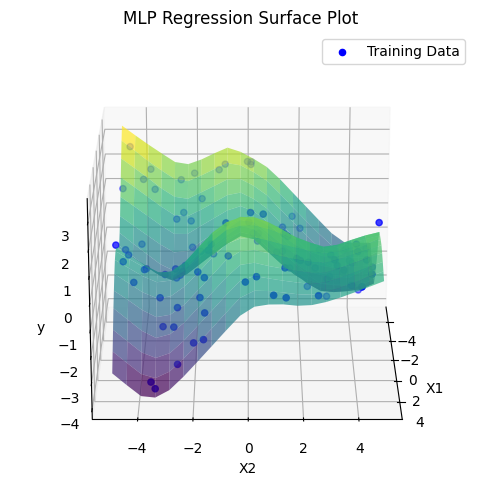

In [21]:
from sklearn.neural_network import MLPRegressor

# Step 1: Define and Train the Model
mlp_regressor = MLPRegressor(hidden_layer_sizes=(64, 32), activation='relu', solver='adam',
                             max_iter=1000, random_state=42)

mlp_regressor.fit(dataset["X"], dataset["y"])

# Step 2: Visualize the Model's Predictions
plot_model_3d(mlp_regressor.predict, X, y, scaler=scaler, title="MLP Regression Surface Plot")


# **VIII To Do**
* In addition to `adam` what other solvers/optimizers has `sklarn`, TF, Torch?
*  Try different optimizers on the same dataset.
* Compare training time, accuracy, and loss curves.
* Experiment with learning rates for Adam vs. SGD.